In [30]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage.feature import peak_local_max
from collections import deque

In [31]:
class Watershed:
    MASK = -2  # Placeholder for unprocessed pixels
    WSHD = 0   # Watershed lines separating regions
    INIT = -1  # Initial state of pixels
    INQE = -3  # Pixels in the queue for processing

    def __init__(self):
        """Initialize the Watershed class."""
        pass

    def _get_neighbors(self, height, width, pixel):
        """
        Retrieves the neighboring pixel coordinates for a given pixel,
        ensuring the neighbors are within image boundaries.
        """
        return [
            (r, c)
            for r in range(max(0, pixel[0] - 1), min(height, pixel[0] + 2))
            for c in range(max(0, pixel[1] - 1), min(width, pixel[1] + 2))
            if (r, c) != pixel
        ]

    def apply(self, image, markers, mask):
        """
        Applies the watershed segmentation algorithm.

        Args:
            image: Distance-transformed image (negative values for basins).
            markers: Initial markers for the watershed algorithm.
            mask: Binary mask restricting the segmentation to foreground.

        Returns:
            labels: Labeled image with each object assigned a unique value.
        """
        height, width = image.shape
        labels = np.full((height, width), self.INIT, dtype=np.int32)

        # Assign initial markers
        for idx, (r, c) in enumerate(zip(*np.nonzero(markers))):
            labels[r, c] = idx + 1  # Start labels from 1

        # Priority queue for processing
        fifo = deque([(r, c) for r, c in zip(*np.nonzero(markers))])

        # Process the priority queue
        while fifo:
            r, c = fifo.popleft()
            for nr, nc in self._get_neighbors(height, width, (r, c)):
                if not mask[nr, nc]:  # Skip background pixels
                    continue
                if labels[nr, nc] == self.INIT:  # Unlabeled pixel
                    labels[nr, nc] = labels[r, c]
                    fifo.append((nr, nc))
                elif labels[nr, nc] != labels[r, c]:  # Conflict (watershed line)
                    labels[r, c] = self.WSHD

        return labels

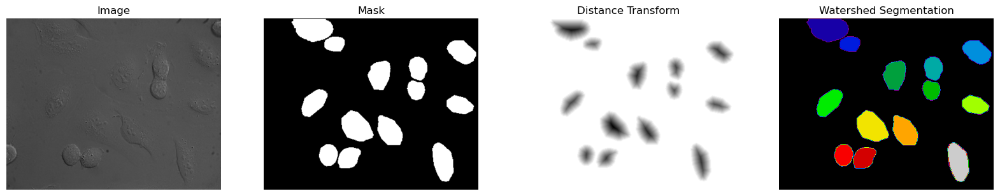

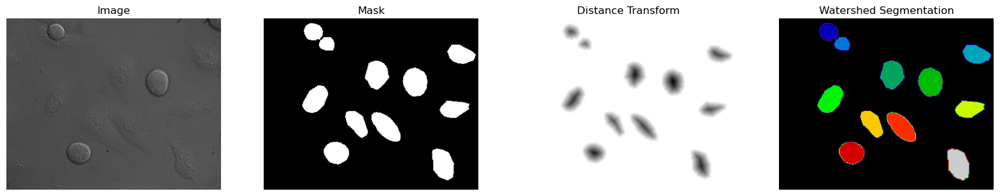

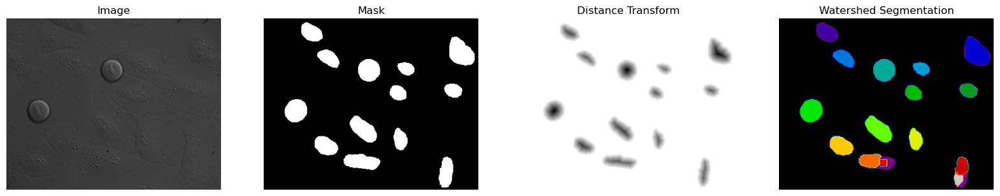

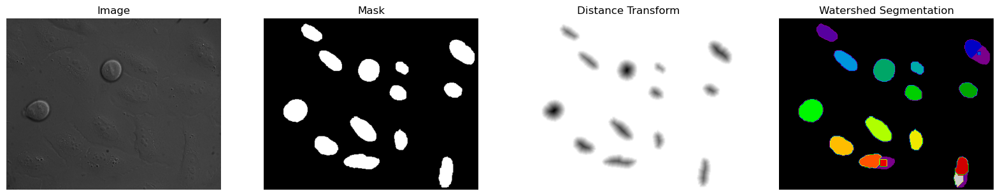

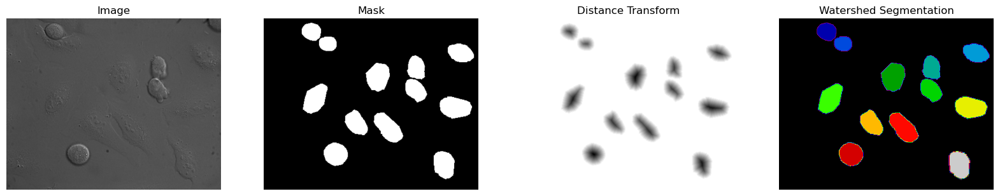

...

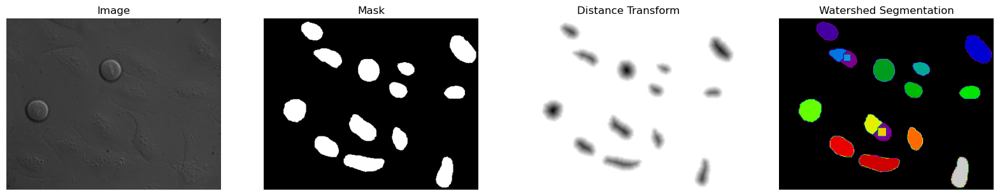

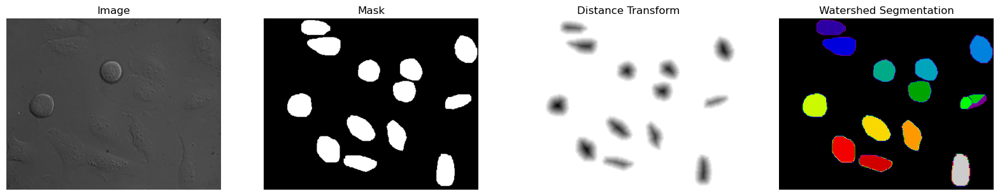

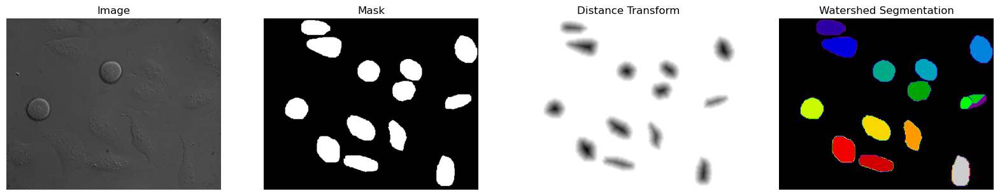

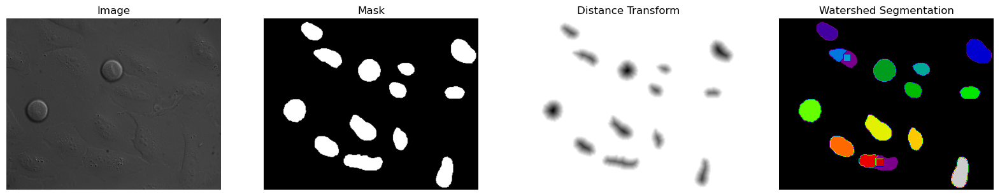

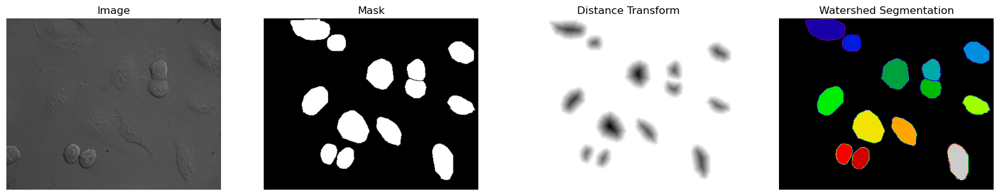

Watershed segmentation completed.


In [32]:
# Directory setup
IMAGE_DIR = "MI01"
MASKS_DIR = f"{IMAGE_DIR}/Masks"
IMAGES_DIR = f"{IMAGE_DIR}/Images"

watershed_video_labels = []

# Instantiate the Watershed class
w = Watershed()

for img in os.listdir(MASKS_DIR):
    # Load the original image and the corresponding mask
    image = cv2.imread(f"{IMAGES_DIR}/I{img[1:]}")
    mask_img = cv2.imread(f"{MASKS_DIR}/{img}")
    mask_img = cv2.cvtColor(mask_img, cv2.COLOR_BGR2GRAY)

    # Threshold the mask to create a binary mask
    _, binary_mask = cv2.threshold(mask_img, 0, 1, cv2.THRESH_BINARY)
    mask = np.array(binary_mask, dtype=bool)

    # Compute the distance transform for the binary mask
    distance_transform = ndi.distance_transform_edt(mask)

    # Detect peaks in the distance transform to use as markers
    coords = peak_local_max(distance_transform, min_distance=20, labels=mask)

    # Initialize markers
    markers = np.zeros(distance_transform.shape, dtype=bool)
    markers[tuple(coords.T)] = True
    markers, _ = ndi.label(markers)

    # Apply the Watershed algorithm
    watershed_labels = w.apply(-distance_transform, markers, mask)

    # Append the results for video processing
    watershed_video_labels.append(watershed_labels)

    # Visualization of the results
    fig, ax = plt.subplots(1, 4, figsize=(20, 15))
    ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax[0].set_title("Image")
    ax[0].axis("off")
    ax[1].imshow(mask, cmap="gray")
    ax[1].set_title("Mask")
    ax[1].axis("off")
    ax[2].imshow(-distance_transform, cmap=plt.cm.gray)
    ax[2].set_title("Distance Transform")
    ax[2].axis("off")
    ax[3].imshow(watershed_labels, cmap=plt.cm.nipy_spectral)
    ax[3].set_title("Watershed Segmentation")
    ax[3].axis("off")

    plt.show()

print("Watershed segmentation completed.")

In [33]:
print(watershed_labels)

[[-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]
 ...
 [-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]]


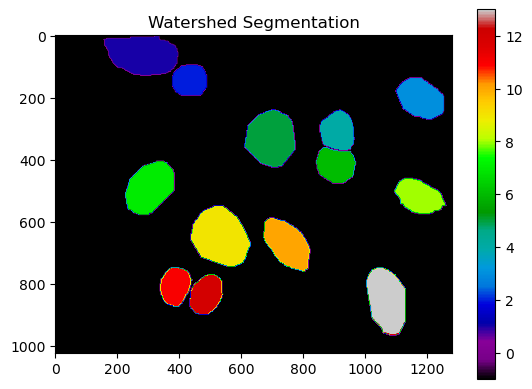

In [34]:
plt.imshow(watershed_labels, cmap='nipy_spectral')
plt.title("Watershed Segmentation")
plt.colorbar()
plt.show()

In [35]:
print(watershed_labels[:10, :10])

[[-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]
 ...
 [-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]
 [-1 -1 -1 ... -1 -1 -1]]


In [36]:
unique_labels = np.unique(watershed_labels)
print(f"Unique labels: {unique_labels}")
print(f"Total objects (excluding background): {len(unique_labels) - 1}")

Unique labels: [-1  1  2 ... 11 12 13]
Total objects (excluding background): 13


[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [18]:
np.savetxt("watershed_object_labels_.txt", watershed_labels, fmt='%d')

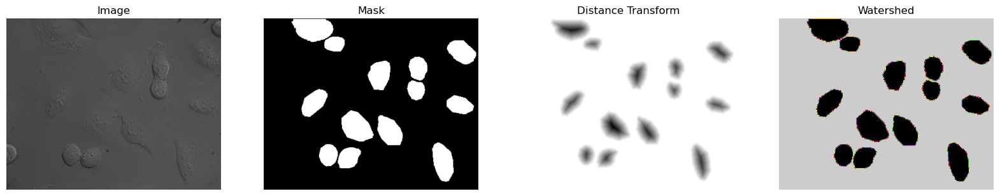

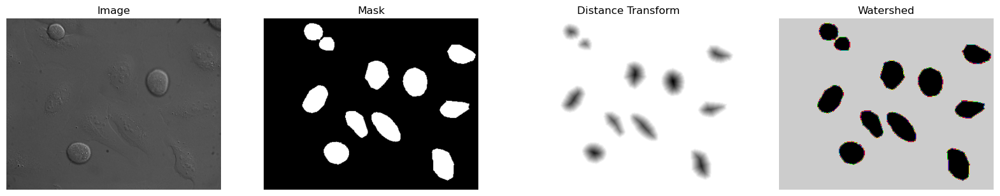

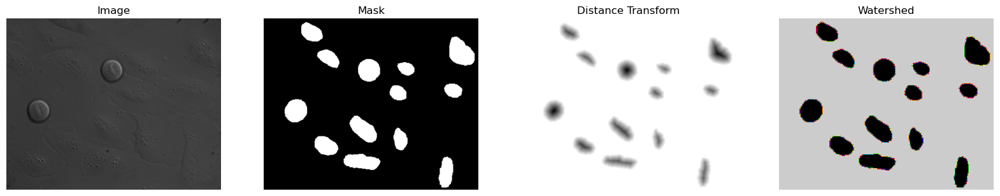

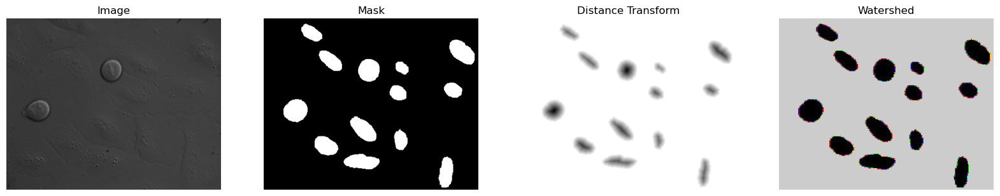

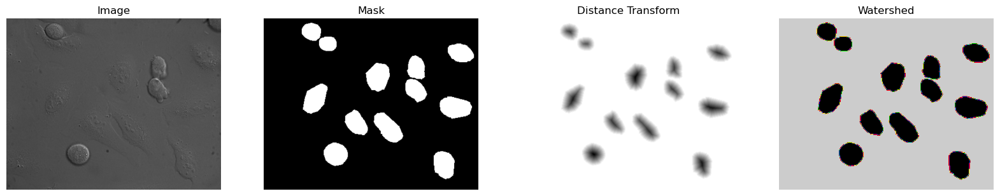

...

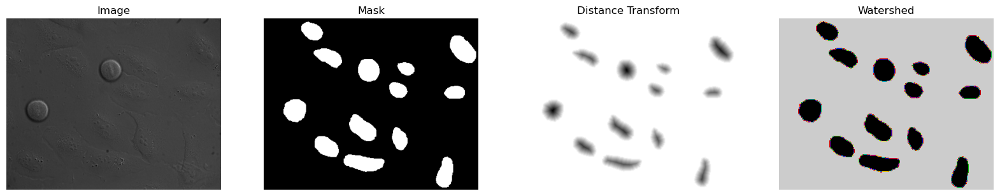

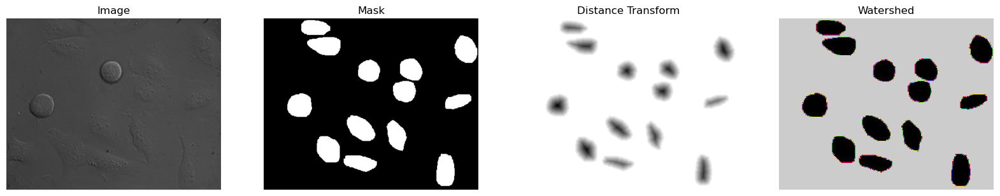

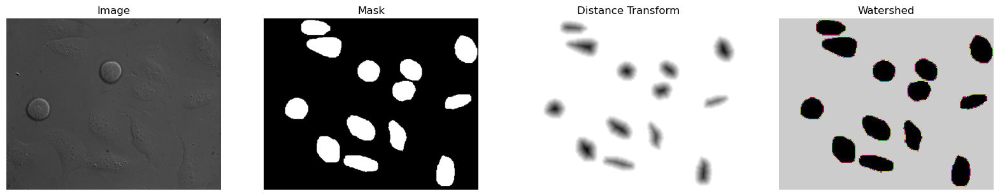

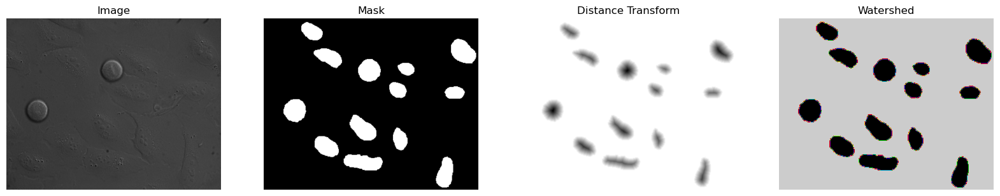

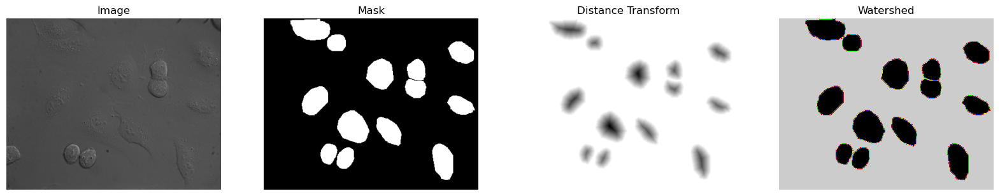

Watershed segmentation completed.


In [21]:
# Directory setup
IMAGE_DIR = "MI01"
MASKS_DIR = f"{IMAGE_DIR}/Masks"
IMAGES_DIR = f"{IMAGE_DIR}/Images"

watershed_video_labels = []
watershed_video_markers = []

# Instantiate the Watershed class
w = Watershed()

for img in os.listdir(MASKS_DIR):
    # Load the original image and the corresponding mask
    image = cv2.imread(f"{IMAGES_DIR}/I{img[1:]}")
    mask_img = cv2.imread(f"{MASKS_DIR}/{img}")
    mask_img = cv2.cvtColor(mask_img, cv2.COLOR_BGR2GRAY)

    # Threshold the mask to create a binary mask
    _, binary_mask = cv2.threshold(mask_img, 0, 1, cv2.THRESH_BINARY)
    mask = np.array(binary_mask, dtype=bool)

    # Compute the distance transform for the binary mask
    distance_transform = ndi.distance_transform_edt(mask)

    # Detect peaks in the distance transform to use as markers
    coords = peak_local_max(distance_transform, min_distance=40, labels=mask)

    # Initialize markers
    watershed_mask = np.zeros(distance_transform.shape, dtype=bool)
    watershed_mask[tuple(coords.T)] = True
    markers, _ = ndi.label(watershed_mask)

    # Apply the Watershed algorithm
    watershed_labels = w.apply(-distance_transform, mask)

    # Append the results for video processing
    watershed_video_labels.append(watershed_labels)
    watershed_video_markers.append(markers)

    # Visualization of the results
    fig, ax = plt.subplots(1, 4, figsize=(20, 15))
    ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax[0].set_title("Image")
    ax[0].axis("off")
    ax[1].imshow(mask, cmap="gray")
    ax[1].set_title("Mask")
    ax[1].axis("off")
    ax[2].imshow(-distance_transform, cmap=plt.cm.gray)
    ax[2].set_title("Distance Transform")
    ax[2].axis("off")
    ax[3].imshow(watershed_labels, cmap=plt.cm.nipy_spectral)
    ax[3].set_title("Watershed")
    ax[3].axis("off")

    plt.show()

print("Watershed segmentation completed.")

In [22]:
print(watershed_labels)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [26]:
unique_labels = np.unique(watershed_labels)
print(f"Unique labels: {unique_labels}")
print(f"Total objects (excluding background): {len(unique_labels) - 1}")

Unique labels: [-2  0]
Total objects (excluding background): 1
